# Visualizations

Polarityjam optionally plots some of the features mentioned above for all cells. All plots are optionally.
If the plots are not needed we recommend to disable plotting in the paramters file to speed up calculation time.
The following visualizations can be generated:

- segmentation
- length to width ratio
- eccentricity
- organelle polarity
- cue intensity ratios
- cue direction asymmetry
- marker expression
- marker polarity
- marker nucleus orientation
- nucleus displacement orientation
- junction features
- junction polarity
- thresholded mask
- cell corners
- feature of interest


<div class="alert alert-info">

Note

Please look at [Python API](https://polarityjam.readthedocs.io/en/latest/notebooks/polarityjam-notebook.html) for code usage.

</div>

In [18]:
%load_ext autoreload
%autoreload 2

from polarityjam import Extractor, Plotter, PropertiesCollection, SegmentationMode
from polarityjam import RuntimeParameter, PlotParameter, SegmentationParameter, ImageParameter, load_segmenter
from polarityjam.utils.io import read_image

from pathlib import Path

### ADAPT ME ###

path_root = Path("")
input_file = path_root.joinpath("data/golgi_nuclei/set_2/060721_EGM2_18dyn_02.tif")
output_path = path_root.joinpath("polarityjam_out/")
output_file_prefix = "060721_EGM2_18dyn_02"

### ADAPT ME ###

img = read_image(input_file)

params_image = ImageParameter()
params_image.channel_organelle = 0  # golgi channel
params_image.channel_nucleus = 2
params_image.channel_junction = 3
params_image.channel_expression_marker = 3
params_image.pixel_to_micron_ratio = 2.4089

r = RuntimeParameter()

cellpose_segmentation, _ = load_segmenter(r)
img_channels, img_channels_params = cellpose_segmentation.prepare(img, params_image)
mask = cellpose_segmentation.segment(img_channels, input_file)
mask_nuc = cellpose_segmentation.segment(img_channels, input_file, mode=SegmentationMode.NUCLEUS)

collection = PropertiesCollection()
extractor = Extractor(RuntimeParameter())
extractor.extract(img, params_image, mask, output_file_prefix, output_path, collection, segmentation_mask_nuclei=mask_nuc)

plotter = Plotter(PlotParameter({"dpi": 200}));

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Segmentation
------------
Segmentation of input image(s) is done with cellpose. Quality control of the segmentation output is a crucial step
for further downstream analysis. For the same purpose, the feature extraction pipeline creates for every input image,
a plot showing the given channel configuration and the corresponding segmentation. An example can be seen below.
Here, first image (from left to right) is the junction channel, second the nuclei channel, and third the
segmentation mask.

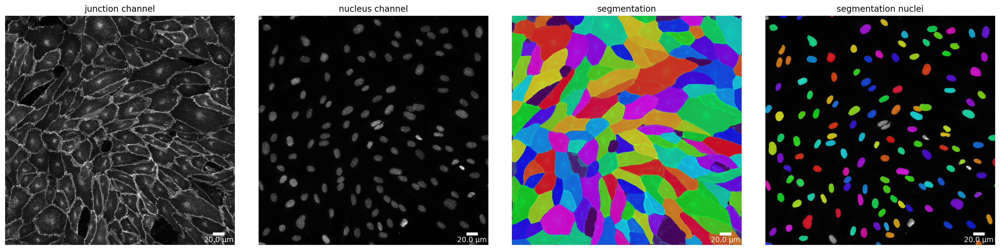

In [19]:
plotter.plot_mask(mask, img_channels, img_channels_params, output_path, output_file_prefix, mask_nuclei=mask_nuc);

Elongation
----------

This plot shows the elongation of each cell and its corresponding nucleus in an input image.
The color ranging from blue to red giving a visual impression of the length to width ratio. Mathematically,
this is simply the ratio of the major and the minor axis of a cell. The higher the value, the more elongated the cell is.


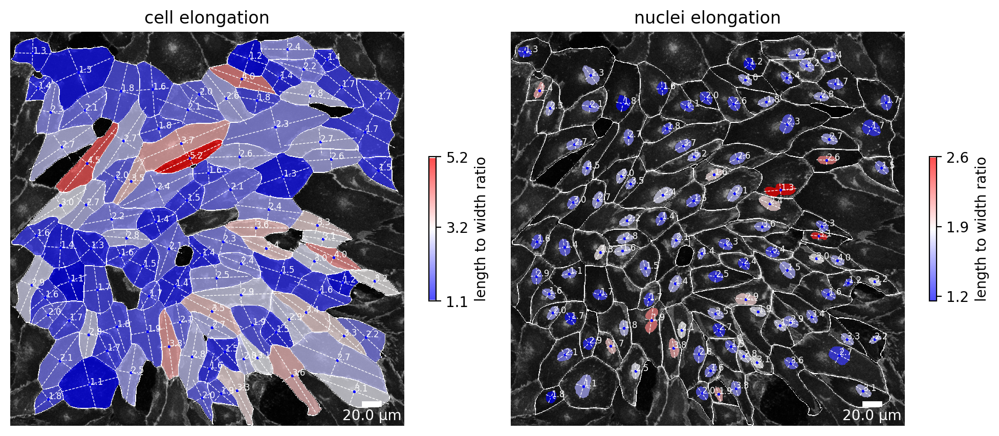

In [20]:
plotter.plot_length_to_width_ratio(collection, "060721_EGM2_18dyn_02");

Another way to visualize the elongation of a cell is to plot the eccentricity. This plot shows the eccentricity of each cell and its corresponding nucleus in an input image.
The color ranging from blue to red giving a visual impression of the eccentricity. Mathematically,
eccentricity is a non-negative real number that uniquely characterizes the shape of a conic section.
Since cells are closed and always form at most an ellipse the value can never be larger than or equal to 1.
Hence, the eccentricity here is a value ranging from 0 (here: blue) to close to 1 (here: red).

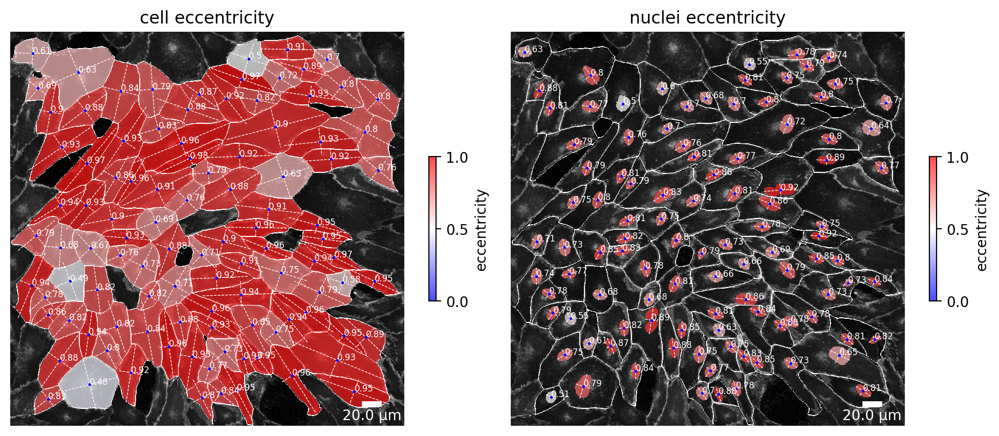

In [21]:
plotter.plot_eccentricity(collection, "060721_EGM2_18dyn_02");

Organelle polarity
------------------
If a golgi channel is present in the input images the organelle polarity plot can be enabled.
From the vector between the position of the center of the golgi apparatus and the position of the center of
the nucleus a polarity angle can be calculated. This angle has the value 0 if nucleus and golgi apparatus both lie on
the same height of the horizontal axis and the nuclei is positioned to the left of the golgi apparatus.
In the other case, when the nuclei is positioned to the right, the angle becomes 180°.
The vector is depicted in white, the nucleus contour in blue and the golgi area in red. Additionally,
a color gradient transparently tints the cells based on their organelle polarity angle.


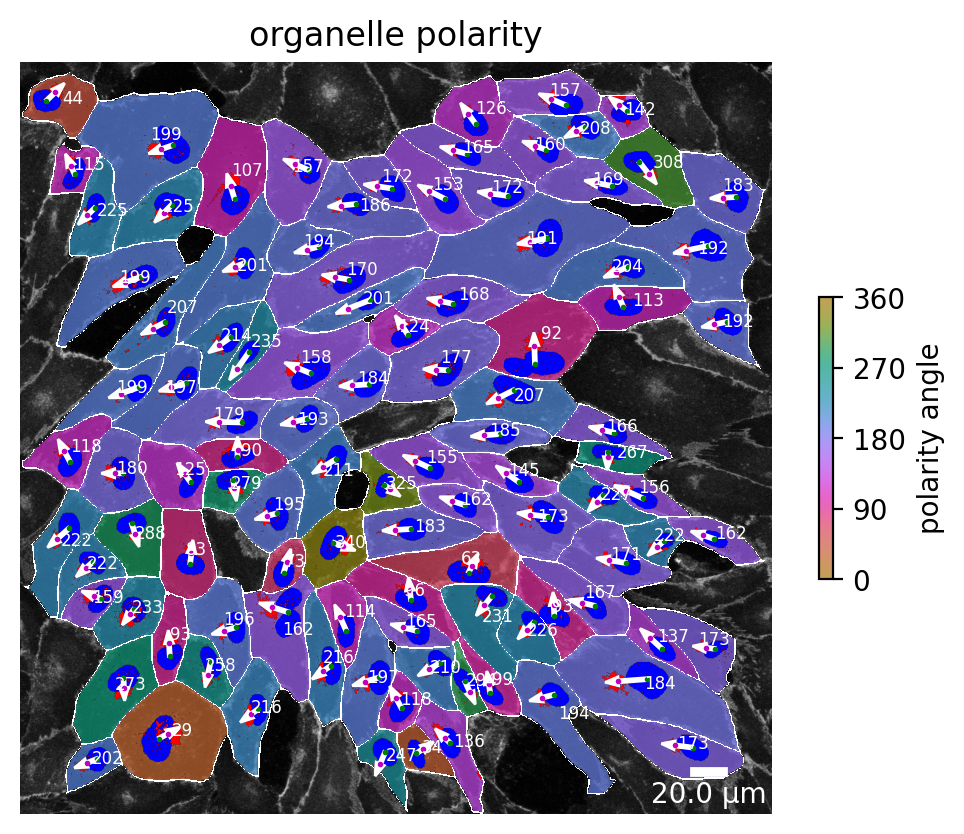

In [22]:
plotter.plot_organelle_polarity(collection, "060721_EGM2_18dyn_02");

Cue intensity ratios
--------------------
Users can define a cue direction. Based on that direction, each cell is divided into two halves (left) or quarters (right). The intensity of the junction channel is then calculated for each half or quarter.
In this example, the cue direction is set to be 0°. Hence, cue direction is defined over the x-axis from left to right. The directional intensity ratio is then defined as the ratio of the intensity of the left half divided by the intensity of the right half.
The axial intensity ratio is defined as the ratio of the sum of the intensity of the quarter relative left to the centroid of the cell in cue direction and the intensity of the quarter relative right to the centroid of the cell in cue direction divided by the total amount of junction intensity.

The same calculation is repeated for the marker channel and shown in the second figure.

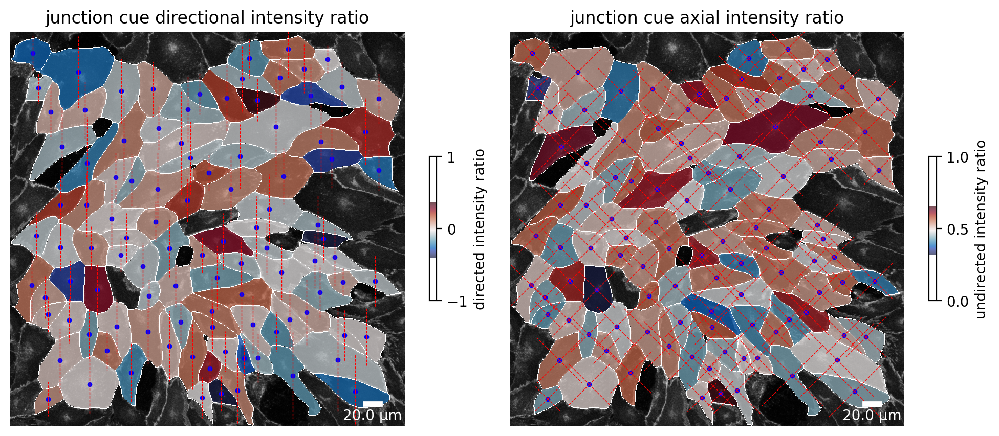

In [23]:
plotter.plot_junction_cue_intensity_ratio(collection, "060721_EGM2_18dyn_02");

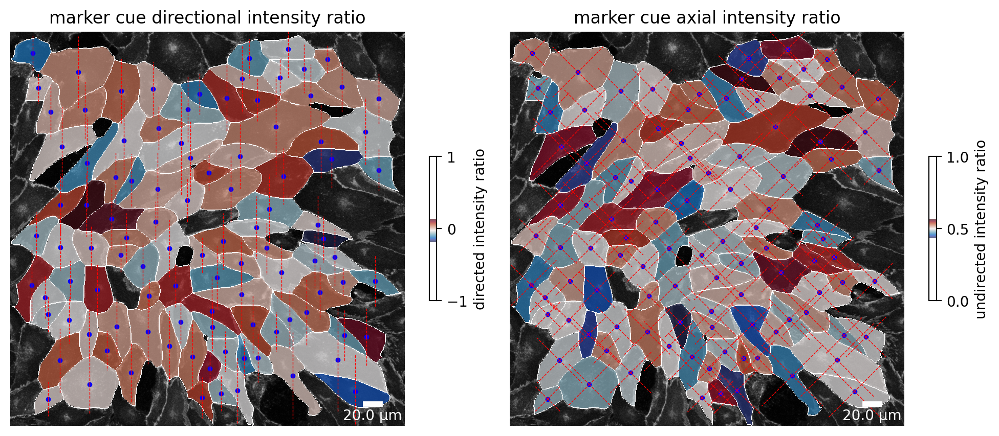

In [24]:
plotter.plot_marker_cue_intensity_ratio(collection, "060721_EGM2_18dyn_02");

Cue direction symmetry
----------------------

The cue direction symmetry plot shows the asymmetry of each cell in the direction of the cue. First, the cell is split in half orthogonal to the given cue direction. Each cell half is then flipped along this axis. From the corresponding two cells the Intersection over Union (IoU) is calculated. The IoU is a value between 0 and 1, where 0 means no overlap and 1 means complete overlap. Hence, a value close to 1 means that the cell is symmetric in the direction of the cue, a value towards 0 indicates a high asymmetry along the cue direction.

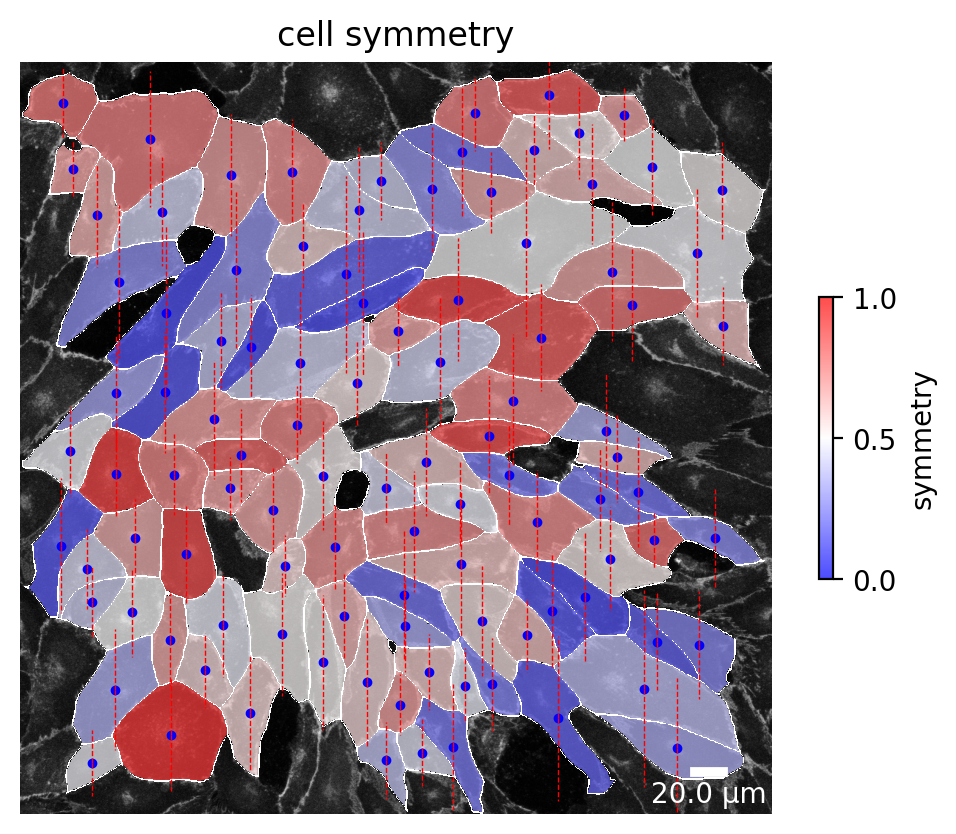

In [25]:
plotter.plot_symmetry(collection, "060721_EGM2_18dyn_02");

Cell shape and nuclei shape orientation
---------------------------------------
The shape and nuclei orientation plot shows the angle that spans between the horizontal axis of the cell to the major
axis of the cell, where an angle of 0 means the major axis of the cell is perfectly horizontal.
Because a cell has no head and tail the angle can only span from 0° to maximal 180°. For visual aid, a color
gradient colors the cell based on the value of its orientation.


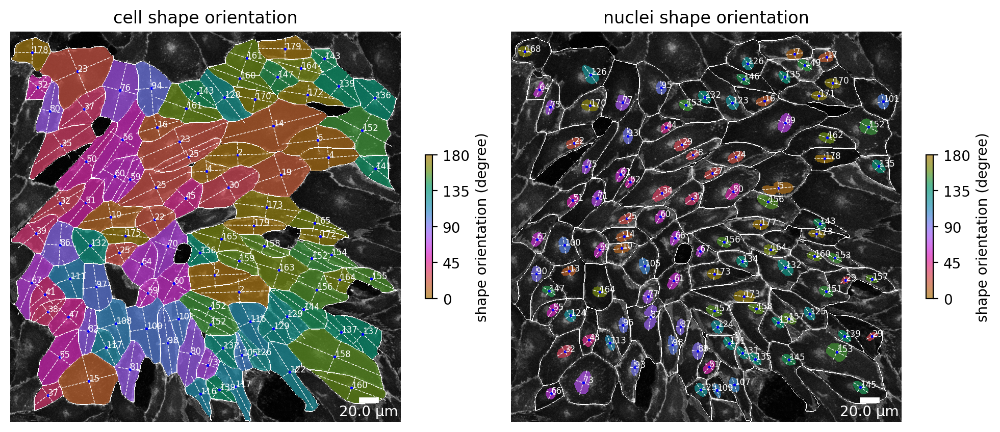

In [26]:
plotter.plot_shape_orientation(collection, "060721_EGM2_18dyn_02");

Marker expression
-----------------

If a channel for the marker expression is given, the intensity of that channel can be visualized in each cell.
This is shown in the following plot in the first image. Additionally, the mean intensity of the junctions are
visualized in the second image. This graphical representation highly depends on the parameter
"membrane thickness" which should be set appropriately. The mean intensity of the nucleus is shown in
the third image and is only present if a nucleus channel is provided.


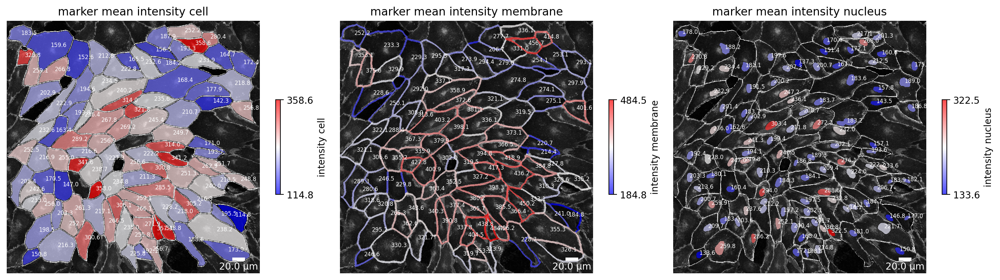

In [27]:
plotter.plot_marker_expression(collection, "060721_EGM2_18dyn_02");

Marker polarity
---------------

The marker polarity shows the polarity for each cell for the marker expression.
The angle between the center of the cell (green dot) and the weighted center of the marker channel of the cell
(red dot) span a vector that is shown as a white arrow. Again, this angle has a value of 0 if the weighted marker
center is positioned on the same horizontal height and to the right of the center of the cell. The value takes 180
if the weighted marker center is position to the left, but still on the same horizontal axis.


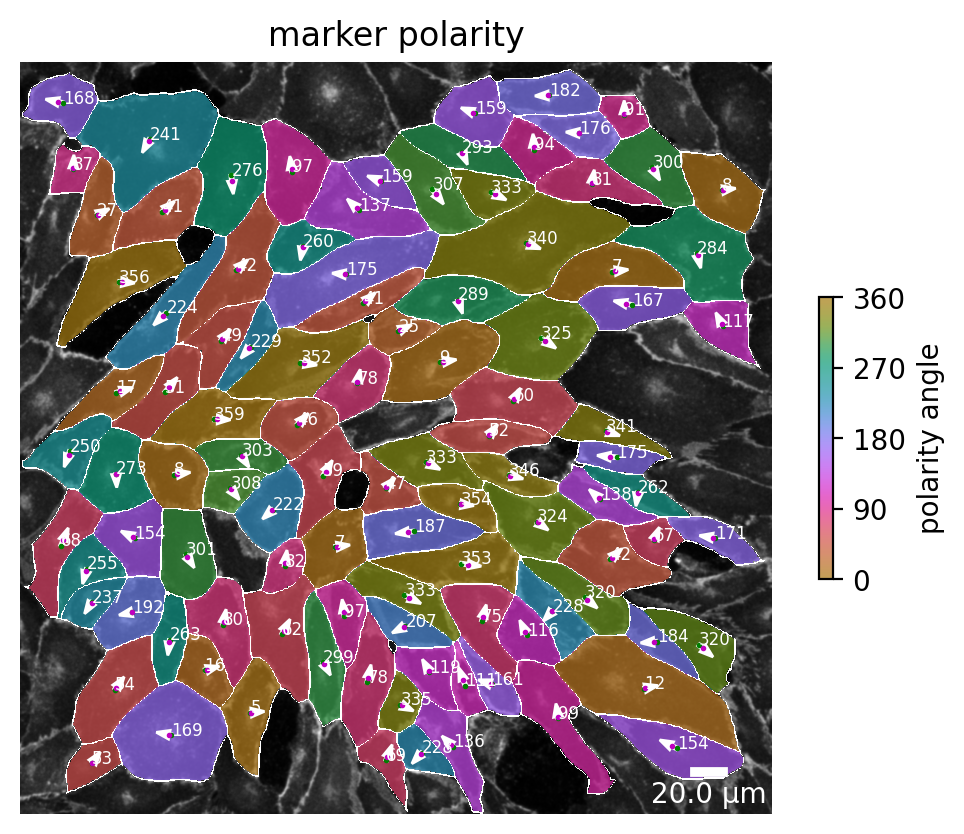

In [28]:
plotter.plot_marker_polarity(collection, "060721_EGM2_18dyn_02");

Marker nucleus orientation
--------------------------

This visualization shows the angle between the center of the nucleus (green dot) and the weighted center of the
marker channel of the cell (red dot). The angle has a value of 0 if the weighted marker center is positioned on the
same horizontal height and to the right of the center of the nucleus. The value takes 180 if the weighted marker
center is position to the left, but still on the same horizontal axis.


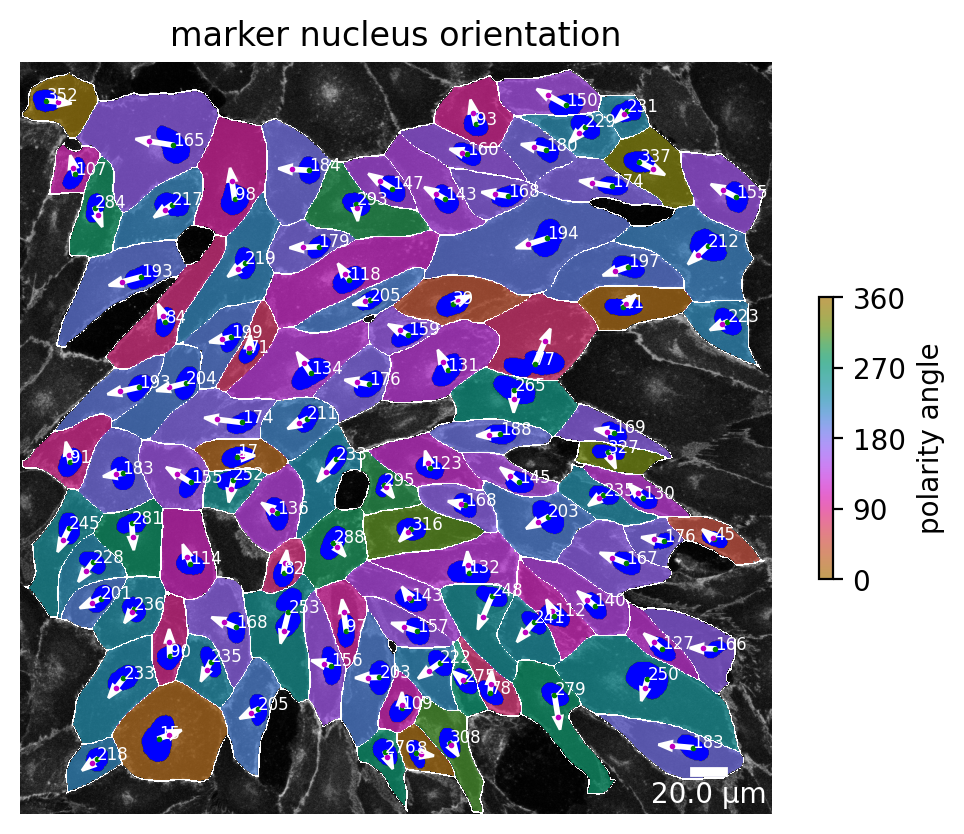

In [29]:
plotter.plot_marker_nucleus_orientation(collection, "060721_EGM2_18dyn_02");

Junction features
-----------------
Here you can observe a visualization of junction features. We show the junction interface occupancy, junction intensity per interface area and junction cluster density.

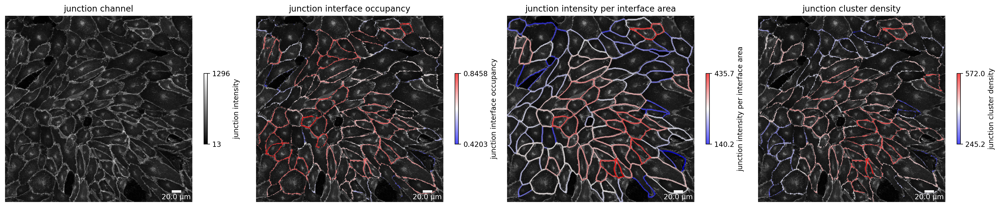

In [30]:
plotter.plot_junction_features(collection, "060721_EGM2_18dyn_02");

Junction polarity
-----------------

The same analysis as has been done for the marker polarity with the marker channel can be done
with the junction channel. Again, the angle between center of the cell and the weighted center of the
junction channel can be calculated. The result can be visualized in the same way as before and is shown
in the image below.

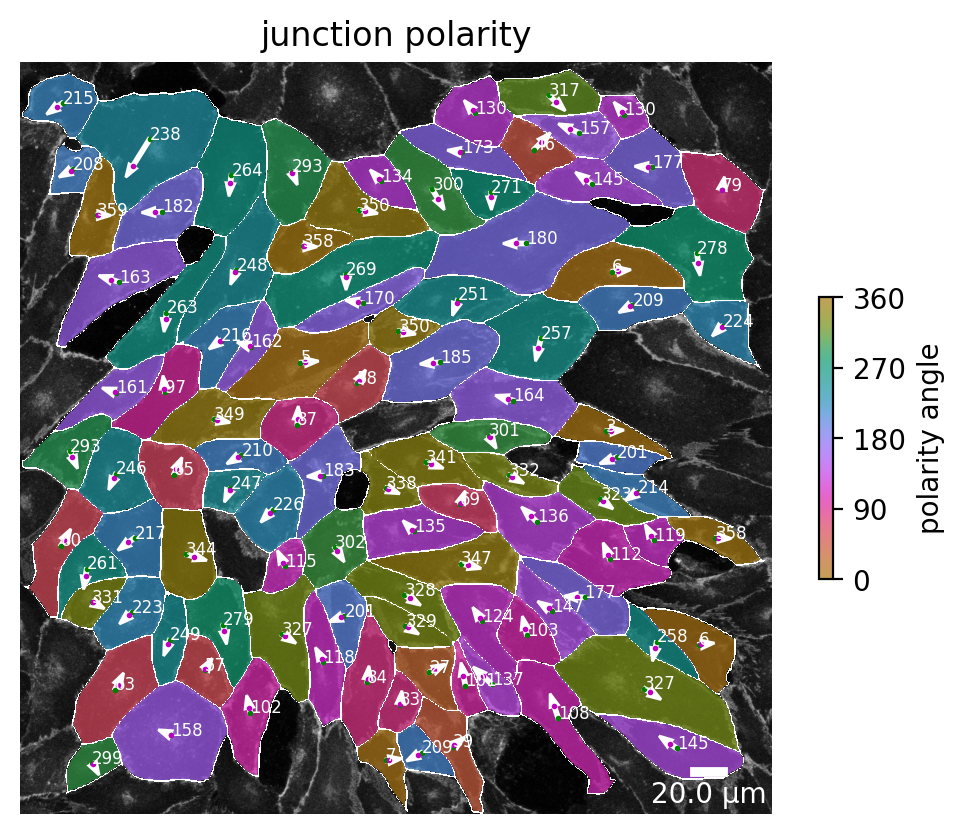

In [31]:
plotter.plot_junction_polarity(collection, "060721_EGM2_18dyn_02");

Nucleus displacement orientation
--------------------------------

The nucleus displacement orientation shows where the nucleus is moving in relation to the cell center.
The angle between the center of the cell and the nucleus center is calculated.
The result of this calculation is shown in the image below.


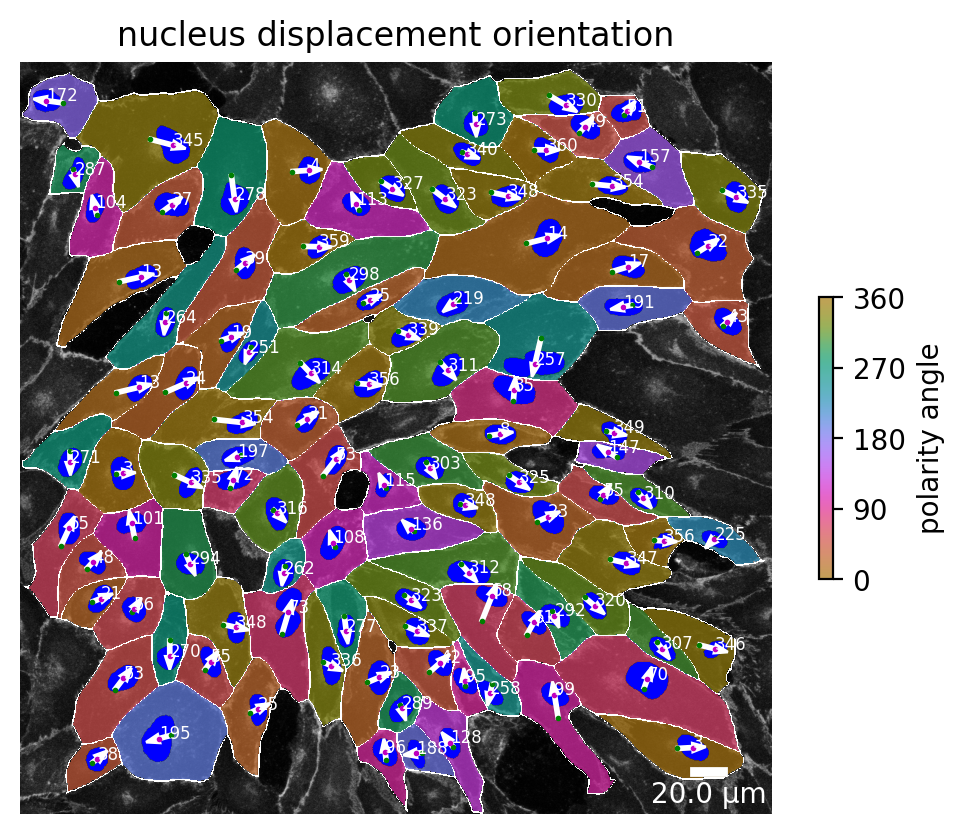

In [32]:
plotter.plot_nuc_displacement_orientation(collection, "060721_EGM2_18dyn_02");

# Thresholded segmentation mask
The thresholded segmentation mask represents the segmented image after applying size and border-based filtering. Cells smaller than a defined size threshold are excluded from the mask. This threshold is specified in the parameters file. Optionally, cells that touch the image borders are also removed, depending on the settings in the parameters file.


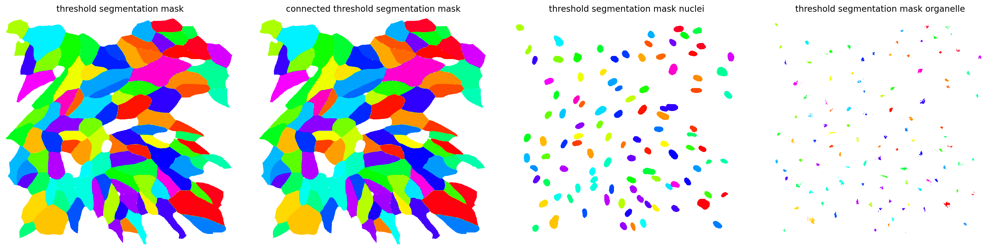

In [33]:
plotter.plot_threshold_segmentation_mask(collection, "060721_EGM2_18dyn_02");

Cell Corners
------------

This plot shows the corners of each cell. The corners are calculated by the douglas-peucker algorithm. The parameter
`dp_epsilon` can be used to adjust the calculation of the corners. The higher the value, the more corners are
calculated. Corners of each cell are shown in the same color. Some corner points are not shown because they are
too close to each other or overlap.

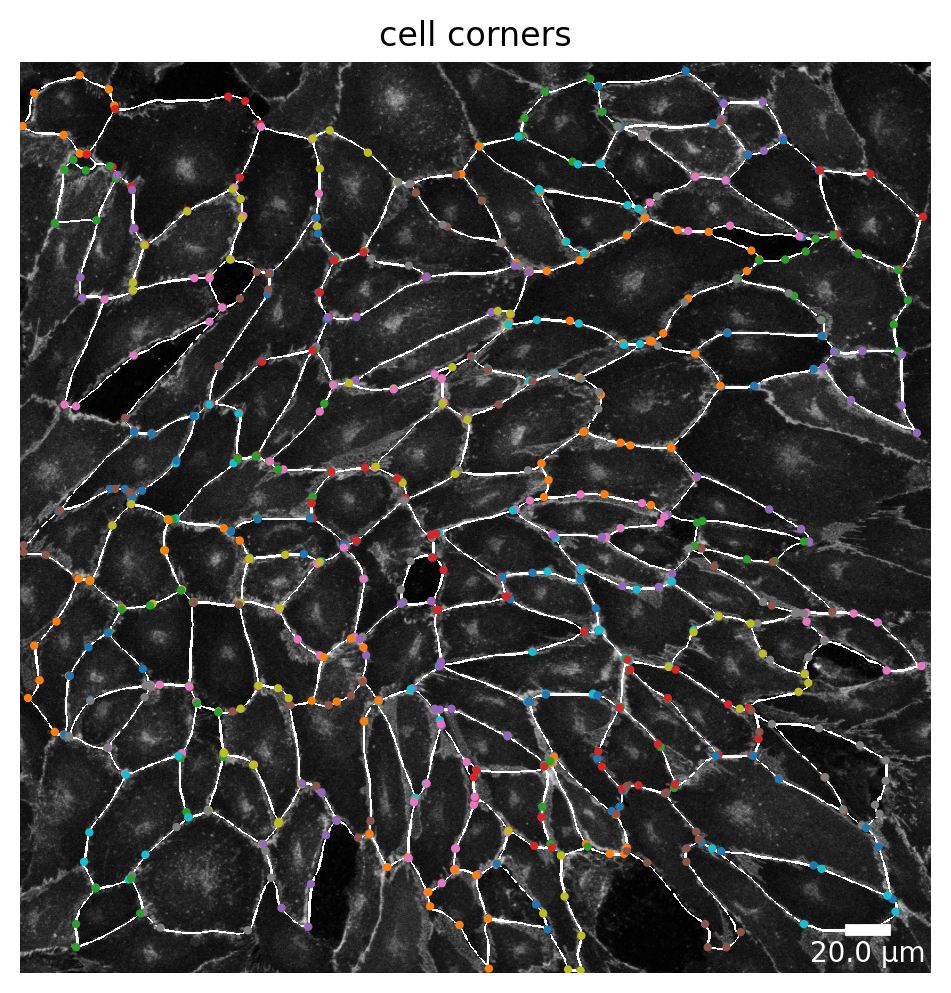

In [34]:
plotter.plot_corners(collection, "060721_EGM2_18dyn_02");

Feature of interest
-------------------

For the analysis, a feature of interest can be chosen. For each cell this feature is then calculated and visualized.
This plot is still under construction and will be updated soon.

Here is already a sneak peak:


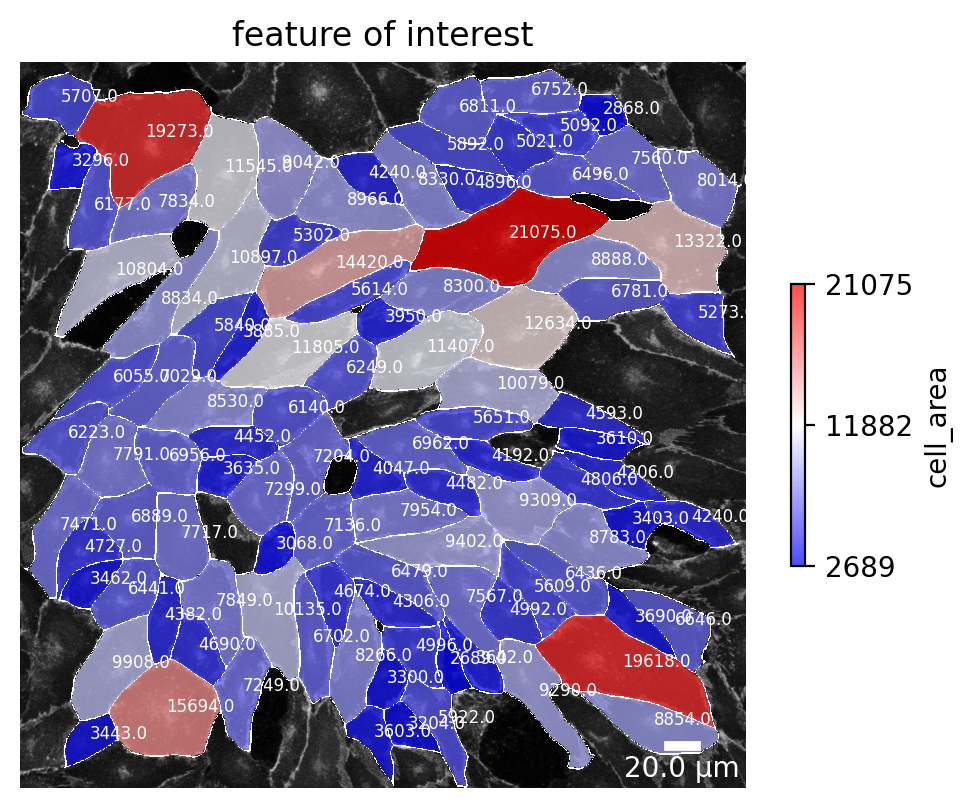

In [35]:
plotter.plot_foi(collection, "060721_EGM2_18dyn_02");